In [1]:
#!pip install torch 
#!pip install torchsummary
#!pip install torchvision
#!pip install --user torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms, datasets
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix
from tqdm import tqdm
import time
from scipy.stats import gaussian_kde
import os
import torch.nn.functional as F
from torchsummary import summary
from torch.utils.data import DataLoader, random_split
from model_structure import CNN
from scipy.stats import gaussian_kde
from collections import OrderedDict
import random
import math

In [ ]:
class ModelComparison:
    def __init__(self, model1, model2, model_name1='Model 1', model_name2='Model 2'):
        self.model1 = model1
        self.model2 = model2
        self.features1 = OrderedDict()
        self.features2 = OrderedDict()
        self.hooks = []
        self.model_name1 = model_name1
        self.model_name2 = model_name2
        
    def register_hooks(self):
        def get_features1(name):
            def hook(module, input, output):
                self.features1[name] = output.detach()
            return hook
            
        def get_features2(name):
            def hook(module, input, output):
                self.features2[name] = output.detach()
            return hook
        
        # Clear previous hooks and features
        self.remove_hooks()
        self.features1.clear()
        self.features2.clear()
        
        # Register new hooks
        for name1, m1 in self.model1.named_modules():
            if isinstance(m1, (nn.Conv2d, nn.Linear)):
                self.hooks.append(m1.register_forward_hook(get_features1(name1)))
                print(f"Registered hook for model1: {name1}")
                
        for name2, m2 in self.model2.named_modules():
            if isinstance(m2, (nn.Conv2d, nn.Linear)):
                self.hooks.append(m2.register_forward_hook(get_features2(name2)))
                print(f"Registered hook for model2: {name2}")
    
    def remove_hooks(self):
        for hook in self.hooks:
            hook.remove()
        self.hooks.clear()

    def give_input(self, input_tensor):
        if not self.hooks:
            self.register_hooks()
            
        # Forward pass
        self.model1.eval()
        self.model2.eval()
        with torch.no_grad():
            _ = self.model1(input_tensor)
            _ = self.model2(input_tensor)

    def visualize_feature_maps_h(self,linear_viz_type='distribution', plot_linear=True, max_features=16):
        feature_maps_1 = self.features1
        feature_maps_2 = self.features2

        for layer_name, fmap1 in feature_maps_1.items():
            if layer_name not in feature_maps_2:
                print(f"Layer {layer_name} not found in {self.model_name2}. Skipping.")
                continue
            
            fmap2 = feature_maps_2[layer_name]
            print(f"Visualizing Layer: {layer_name}")
            
            # Ensure tensors are on CPU and detached
            fmap1 = fmap1.detach().cpu()
            fmap2 = fmap2.detach().cpu()
            
            # Handle Convolutional Layers
            if fmap1.dim() == 4 and fmap2.dim() == 4:
                # [Previous convolutional layer visualization code remains the same]
                _, num_channels, _, _ = fmap1.shape
                num_features = min(num_channels, max_features)
                selected_indices = np.linspace(0, num_channels - 1, num_features, dtype=int)
                
                fig, axes = plt.subplots(2, num_features, figsize=(num_features * 3, 6))
                for idx, feature_idx in enumerate(selected_indices):
                    # Model 1 Feature Map
                    fmap1_np = fmap1[0, feature_idx].numpy()
                    axes[0, idx].imshow(fmap1_np, cmap='viridis')
                    axes[0, idx].axis('off')
                    axes[0, idx].set_title(f"{self.model_name1} F{feature_idx}")
                    
                    # Model 2 Feature Map
                    fmap2_np = fmap2[0, feature_idx].numpy()
                    axes[1, idx].imshow(fmap2_np, cmap='viridis')
                    axes[1, idx].axis('off')
                    axes[1, idx].set_title(f"{self.model_name2} F{feature_idx}")
                
                plt.suptitle(f"Convolutional Layer: {layer_name}")
                plt.tight_layout()
                plt.show()
            # Handle Linear Layers
            elif fmap1.dim() == 2 and fmap2.dim() == 2 and plot_linear:
                if linear_viz_type == 'distribution':
                    self._visualize_linear_distribution(fmap1, fmap2,layer_name)
                elif linear_viz_type == 'heatmap':
                    self._visualize_linear_heatmap(fmap1, fmap2, layer_name)
                elif linear_viz_type == 'boxplot':
                    self._visualize_linear_boxplot(fmap1, fmap2, layer_name)
            else:
                print(f"Skipping layer {layer_name} with shapes {fmap1.shape} and {fmap2.shape}")

    def _visualize_linear_distribution(self, fmap1, fmap2, layer_name):

        # Convert tensors to numpy arrays
        act1 = fmap1.cpu().numpy().flatten()
        act2 = fmap2.cpu().numpy().flatten()
        diff = np.abs(act1 - act2)
        
        # Create figure with 3 subplots vertically aligned
        fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12))
        #plt.suptitle(f'Activation Distribution: {layer_name}', fontsize=14, y=0.95)
        
        # Plot Model 1 distribution
        sns.histplot(data=act1, bins=50, kde=True, ax=ax1, color='blue')
        ax1.set_title('Model 1 Activations')
        ax1.set_xlabel('Activation Value')
        ax1.set_ylabel('Count')
        
        # Plot Model 2 distribution
        sns.histplot(data=act2, bins=50, kde=True, ax=ax2, color='green')
        ax2.set_title('Model 2 Activations')
        ax2.set_xlabel('Activation Value')
        ax2.set_ylabel('Count')
        
        # Plot absolute differences
        sns.histplot(data=diff, bins=50, kde=True, ax=ax3, color='red')
        ax3.set_title('Absolute Differences')
        ax3.set_xlabel('Difference Value')
        ax3.set_ylabel('Count')
        
        # Add statistics as text
        stats1 = f'Mean: {np.mean(act1):.3f}\nStd: {np.std(act1):.3f}'
        stats2 = f'Mean: {np.mean(act2):.3f}\nStd: {np.std(act2):.3f}'
        stats_diff = f'Mean: {np.mean(diff):.3f}\nStd: {np.std(diff):.3f}'
        
        ax1.text(0.95, 0.95, stats1, transform=ax1.transAxes, 
                verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        ax2.text(0.95, 0.95, stats2, transform=ax2.transAxes,
                verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        ax3.text(0.95, 0.95, stats_diff, transform=ax3.transAxes,
                verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.tight_layout()
        plt.show()

    def _visualize_linear_heatmap(self,fmap1, fmap2, layer_name):
        # Convert tensors to numpy arrays if they aren't already
        fmap1_np = fmap1.numpy() if not isinstance(fmap1, np.ndarray) else fmap1
        fmap2_np = fmap2.numpy() if not isinstance(fmap2, np.ndarray) else fmap2
        
        # Calculate global min and max for consistent scale
        vmin = min(fmap1_np.min(), fmap2_np.min())
        vmax = max(fmap1_np.max(), fmap2_np.max())
        
        # Create figure with two subplots
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))
        
        # Plot first heatmap with fixed scale
        sns.heatmap(fmap1_np, ax=ax1, cmap='viridis', center=0,
                    vmin=vmin, vmax=vmax, cbar_kws={'label': 'Activation Value'})
        ax1.set_title(f"{self.model_name1} Activations")
        
        # Plot second heatmap with same fixed scale
        sns.heatmap(fmap2_np, ax=ax2, cmap='viridis', center=0,
                    vmin=vmin, vmax=vmax, cbar_kws={'label': 'Activation Value'})
        ax2.set_title(f"{self.model_name2} Activations")
        
        # Add overall title and adjust layout
        plt.suptitle(f"Linear Layer Heatmap: {layer_name}")
        plt.tight_layout()
        plt.show()
        
    def _visualize_linear_boxplot(self, fmap1, fmap2, layer_name):
        # Flatten all values from each model
        values1 = fmap1.cpu().numpy().flatten()
        values2 = fmap2.cpu().numpy().flatten()
        
        # Create figure
        plt.figure(figsize=(10, 6))
        
        # Create box plot
        box_plot = plt.boxplot([values1, values2],
                            labels=[self.model_name1, self.model_name2],
                            patch_artist=True,
                            medianprops=dict(color="red", linewidth=1.5),
                            flierprops=dict(marker='o', markerfacecolor='gray', 
                                            markersize=4, alpha=0.5))
        
        # Customize colors
        box_plot['boxes'][0].set_facecolor('lightblue')
        box_plot['boxes'][1].set_facecolor('lightgreen')
        
        # Add grid for better readability
        plt.grid(True, axis='y', linestyle='--', alpha=0.3)
        
        # Customize plot
        plt.title(f"Activation Value Distributions: {layer_name}")
        plt.ylabel('Activation Values')
        
        # Print statistics
        print(f"\nStatistics for {layer_name}:")
        print(f"{self.model_name1}:")
        print(f"  Mean: {values1.mean():.3f}")
        print(f"  Std:  {values1.std():.3f}")
        print(f"  Min:  {values1.min():.3f}")
        print(f"  Max:  {values1.max():.3f}")
        print(f"\n{self.model_name2}:")
        print(f"  Mean: {values2.mean():.3f}")
        print(f"  Std:  {values2.std():.3f}")
        print(f"  Min:  {values2.min():.3f}")
        print(f"  Max:  {values2.max():.3f}")
        
        plt.tight_layout()
        plt.show()


In [4]:
class Evaluator:
    def __init__(self, model, device, visualizer=None):
        self.model = model
        self.device = device
        self.visualizer = visualizer
        self.best_metrics = {'f1': 0.0}
        self.wrong_predictions = {"images": [], "probs": [], "predictions": [], "targets": []}

    def evaluate(self, test_loader, dataset_classes):
        self.model.eval()
        predictions, targets = [], []
        self.wrong_predictions = {"images": [], "probs": [], "predictions": [], "targets": []}

        with torch.no_grad():
            for inputs, labels in tqdm(test_loader, desc="Evaluating"):
                inputs, labels = inputs.to(self.device), labels.to(self.device)
                outputs = self.model(inputs)
                
                # Handle both single-value and batch predictions
                predicted = (outputs.squeeze() > 0.5).float()
                if predicted.dim() == 0:  # If single value
                    predictions.append(predicted.item())
                    targets.append(labels.item())
                else:  # If batch
                    predictions.extend(predicted.cpu().numpy())
                    targets.extend(labels.cpu().numpy())

                # Store wrong predictions
                if predicted.dim() == 0:
                    wrong_mask = predicted != labels
                    if wrong_mask.item():
                        wrong_inputs = inputs
                        wrong_preds = predicted.unsqueeze(0)
                        wrong_targets = labels.unsqueeze(0)
                        wrong_probs = torch.sigmoid(outputs.squeeze()).unsqueeze(0)
                else:
                    wrong_mask = predicted != labels
                    if wrong_mask.any():
                        wrong_inputs = inputs[wrong_mask]
                        wrong_preds = predicted[wrong_mask]
                        wrong_targets = labels[wrong_mask]
                        wrong_probs = torch.sigmoid(outputs.squeeze())[wrong_mask]

                if 'wrong_inputs' in locals():
                    self.wrong_predictions["images"].extend(wrong_inputs.cpu())
                    self.wrong_predictions["predictions"].extend(
                        [dataset_classes[int(p)] for p in wrong_preds.cpu()])
                    self.wrong_predictions["targets"].extend(
                        [dataset_classes[int(t)] for t in wrong_targets.cpu()])
                    self.wrong_predictions["probs"].extend(wrong_probs.cpu())

        metrics = self._calculate_metrics(predictions, targets)
        return metrics
    
    def _calculate_metrics(self, predictions, targets):
        return {
            'accuracy': accuracy_score(targets, predictions),
            'f1': f1_score(targets, predictions, zero_division=0),
            'precision': precision_score(targets, predictions, zero_division=0),
            'recall': recall_score(targets, predictions, zero_division=0)
        }

    def visualize_wrong_predictions(self, max_images=10):
        if not self.wrong_predictions["images"]:
            print("No wrong predictions to visualize")
            return

        # Create a set to track unique predictions based on image content
        seen_images = set()
        unique_indices = []
        
        # Convert tensors to numpy arrays for comparison
        for idx, img_tensor in enumerate(self.wrong_predictions["images"]):
            img_array = img_tensor.cpu().numpy().tobytes()  # Convert to bytes for hashing
            if img_array not in seen_images:
                seen_images.add(img_array)
                unique_indices.append(idx)
                if len(unique_indices) >= max_images:
                    break

        n_images = len(unique_indices)
        if n_images == 0:
            print("No unique wrong predictions to visualize")
            return

        n_cols = min(5, n_images)
        n_rows = (n_images + n_cols - 1) // n_cols

        fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 4, n_rows * 3))
        if n_rows == 1:
            axes = axes.reshape(1, -1)

        for plot_idx, img_idx in enumerate(unique_indices):
            row, col = plot_idx // n_cols, plot_idx % n_cols
            ax = axes[row, col]
            
            # Handle both RGB and grayscale images
            img = self.wrong_predictions["images"][img_idx].permute(1, 2, 0).cpu().numpy()
            if img.shape[2] == 1:
                img = img.squeeze()
            
            ax.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
            ax.set_title(f'Pred: {self.wrong_predictions["predictions"][img_idx]}\n'
                        f'({self.wrong_predictions["probs"][img_idx]:.2f})\n'
                        f'True: {self.wrong_predictions["targets"][img_idx]}')
            ax.axis('off')

        # Hide empty subplots
        for idx in range(n_images, n_rows * n_cols):
            row, col = idx // n_cols, idx % n_cols
            axes[row, col].axis('off')

        plt.tight_layout()
        plt.show()   

In [5]:
model_1_dir = 'CNN_model_1_final_2024_12_07_23_23_10.pth'
model_2_dir = 'CNN_model_2_final_2024_12_08_00_09_34.pth'
test_data_1_dir = 'RGB_data_for_model_1/test/'
test_data_2_dir = 'RGB_data_for_model_2/test/'
train_data_1_dir = 'RGB_data_for_model_1/train/'
train_data_2_dir = 'RGB_data_for_model_2/train/'

In [6]:
# Load the model
model_1 = CNN()
weights = torch.load(model_1_dir, map_location=torch.device('cpu'))
model_1.load_state_dict(weights['model_state_dict'])
model_1.eval()

model_2 = CNN()
weights = torch.load(model_2_dir, map_location=torch.device('cpu'))
model_2.load_state_dict(weights['model_state_dict'])
model_2.eval()


# Convert input picture to tensor
transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                           std=[0.229, 0.224, 0.225])
    ])

# Load data set
dataset_test_1 = datasets.ImageFolder(test_data_1_dir,transform=transform)
dataset_train_1 = datasets.ImageFolder(train_data_1_dir,transform=transform)
dataset_test_2 = datasets.ImageFolder(test_data_2_dir,transform=transform)
dataset_train_2 = datasets.ImageFolder(train_data_2_dir,transform=transform)

test_loader_1 = DataLoader(dataset_test_1, shuffle=False)
train_loader_1 = DataLoader(dataset_train_1, shuffle=False)
test_loader_2 = DataLoader(dataset_test_2, shuffle=False)
train_loader_2 = DataLoader(dataset_train_2, shuffle=False)



C:\Users\hskay\AppData\Local\Temp\ipykernel_20708\3234625564.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  weights = torch.load(model_1_dir, map_location=torch.device(

In [7]:
evaluator = Evaluator(model_1, "cpu")

Evaluating: 100%|██████████| 3000/3000 [00:51<00:00, 58.04it/s]


Evaluation Results:
accuracy: 0.9993
f1: 0.9993
precision: 1.0000
recall: 0.9987


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


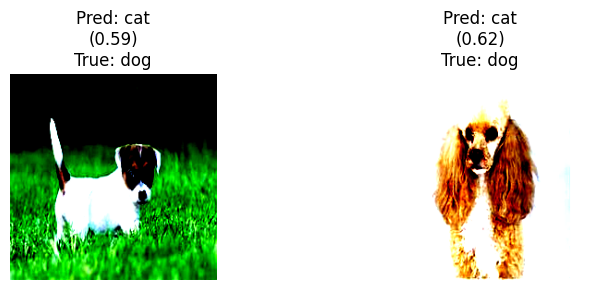

In [8]:
metrics = evaluator.evaluate(train_loader_1, train_loader_1.dataset.classes)
print("Evaluation Results:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")
evaluator.visualize_wrong_predictions()

Evaluating: 100%|██████████| 200/200 [00:04<00:00, 40.04it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB

Evaluation Results:
accuracy: 0.8900
f1: 0.8878
precision: 0.9062
recall: 0.8700


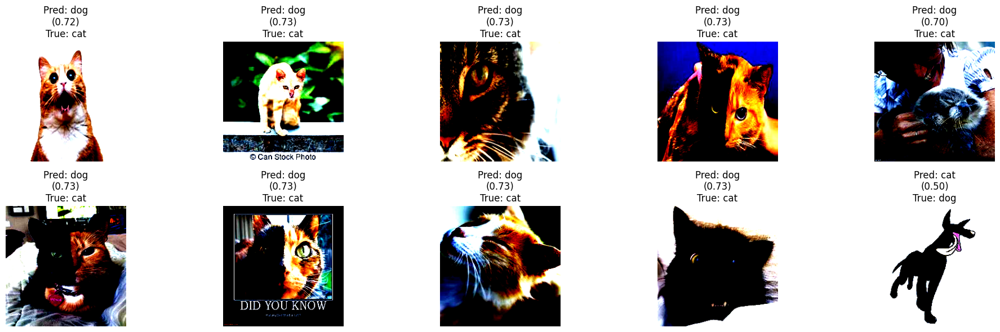

In [9]:
metrics = evaluator.evaluate(test_loader_1, test_loader_1.dataset.classes)
print("Evaluation Results:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")
evaluator.visualize_wrong_predictions()

In [10]:
evaluator = Evaluator(model_2, "cpu")

Evaluating:   0%|          | 0/3000 [00:00<?, ?it/s]

Evaluating: 100%|██████████| 3000/3000 [01:17<00:00, 38.85it/s]


Evaluation Results:
accuracy: 0.9977
f1: 0.9977
precision: 0.9987
recall: 0.9967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


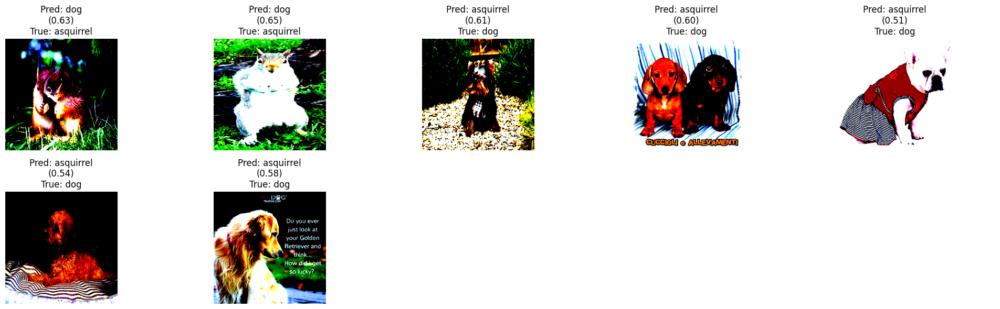

In [11]:
metrics = evaluator.evaluate(train_loader_2, train_loader_2.dataset.classes)
print("Evaluation Results:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")
evaluator.visualize_wrong_predictions()

Evaluating: 100%|██████████| 200/200 [00:05<00:00, 33.94it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB

Evaluation Results:
accuracy: 0.9000
f1: 0.9038
precision: 0.8704
recall: 0.9400


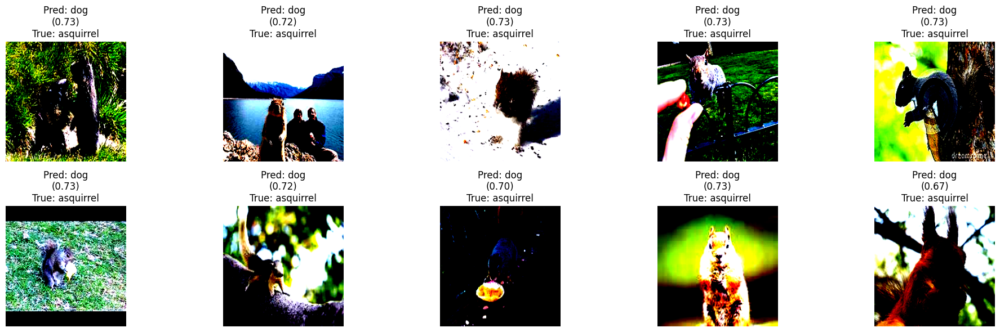

In [12]:
metrics = evaluator.evaluate(test_loader_2, test_loader_2.dataset.classes)
print("Evaluation Results:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")
evaluator.visualize_wrong_predictions()

In [13]:
images = [(img, idx) for idx, (img, label) in enumerate(test_loader_1.dataset) 
            if label == 1]

In [14]:
img, _ = random.choice(images)

In [15]:
with torch.no_grad():
        pred1 = model_1(img.unsqueeze(0))
        pred2 = model_2(img.unsqueeze(0))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


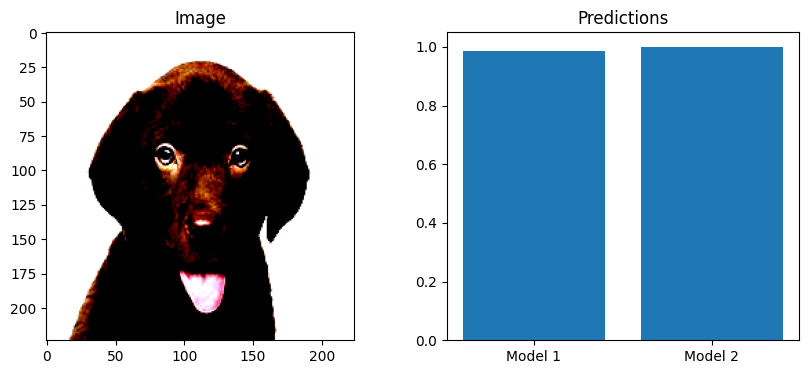

In [16]:
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(img.permute(1, 2, 0))
plt.title('Image')

plt.subplot(1, 2, 2)
plt.bar(['Model 1', 'Model 2'], 
        [pred1.item(), pred2.item()])
plt.title('Predictions')
plt.show()

In [17]:
comparator = ModelComparison(model_1, model_2)
comparator.give_input(img.unsqueeze(0))

Registered hook for model1: conv_layers.0
Registered hook for model1: conv_layers.3
Registered hook for model1: conv_layers.6
Registered hook for model1: conv_layers.9
Registered hook for model1: fc_layers.0
Registered hook for model1: fc_layers.3
Registered hook for model2: conv_layers.0
Registered hook for model2: conv_layers.3
Registered hook for model2: conv_layers.6
Registered hook for model2: conv_layers.9
Registered hook for model2: fc_layers.0
Registered hook for model2: fc_layers.3


Visualizing Layer: conv_layers.0


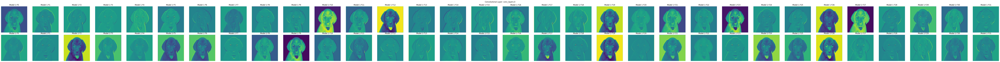

Visualizing Layer: conv_layers.3


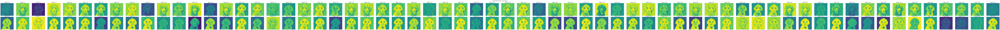

Visualizing Layer: conv_layers.6


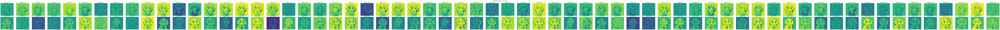

Visualizing Layer: conv_layers.9


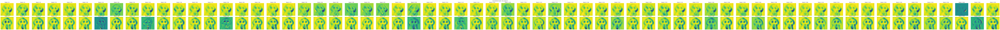

Visualizing Layer: fc_layers.0


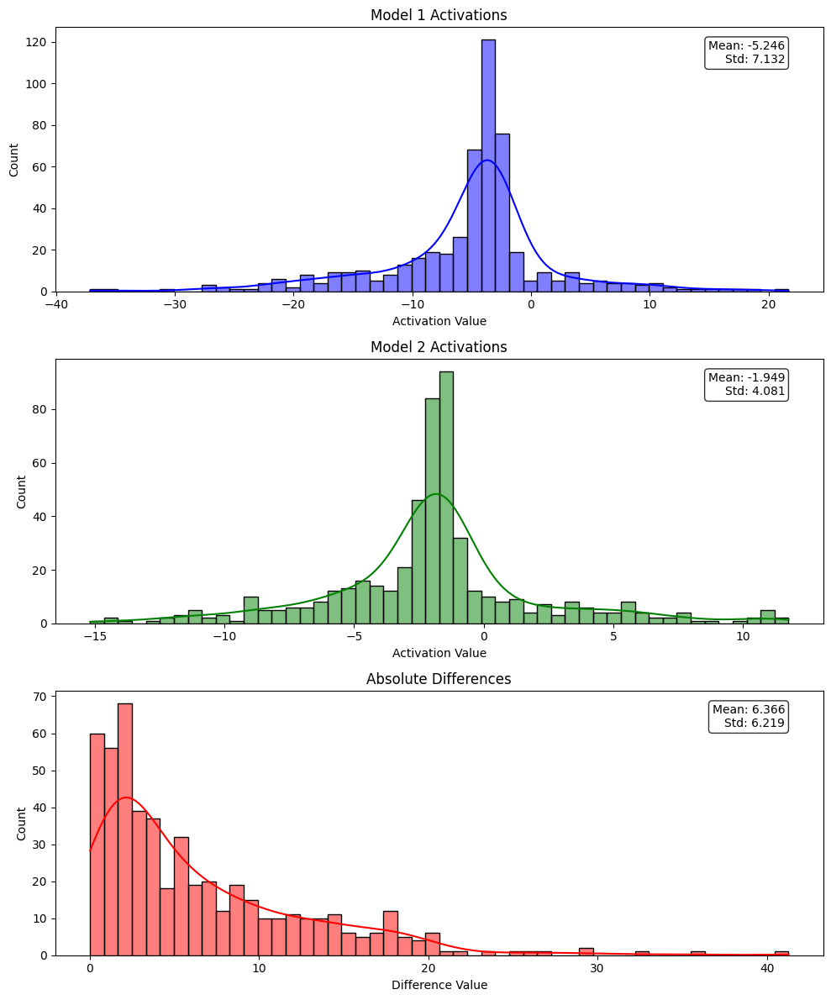

Visualizing Layer: fc_layers.3


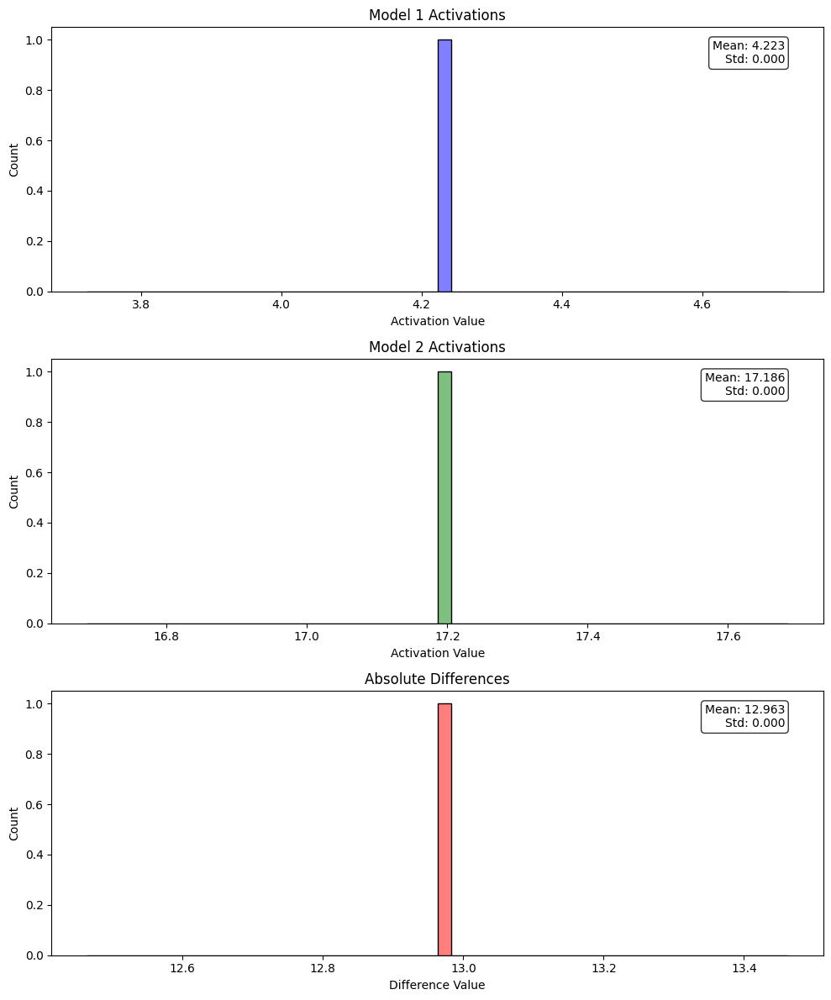

In [21]:
comparator.visualize_feature_maps_h(max_features=64)

Visualizing Layer: conv_layers.0


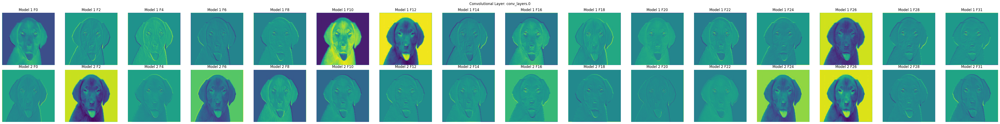

Visualizing Layer: conv_layers.3


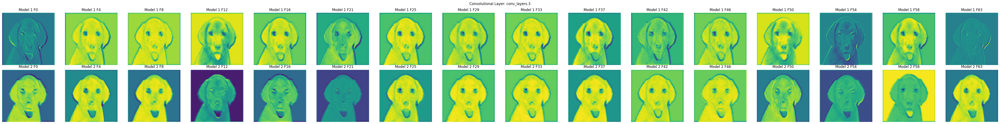

Visualizing Layer: conv_layers.6


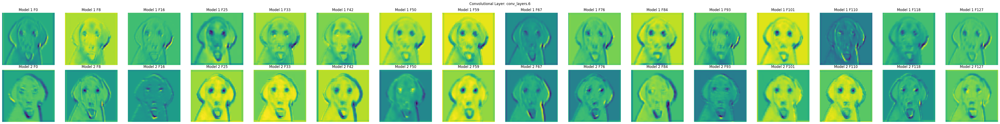

Visualizing Layer: conv_layers.9


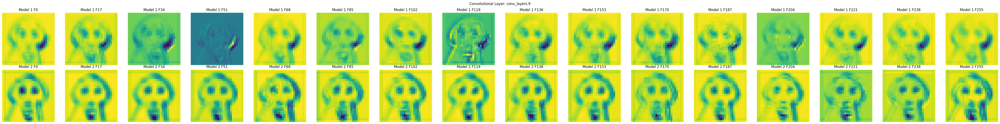

Visualizing Layer: fc_layers.0


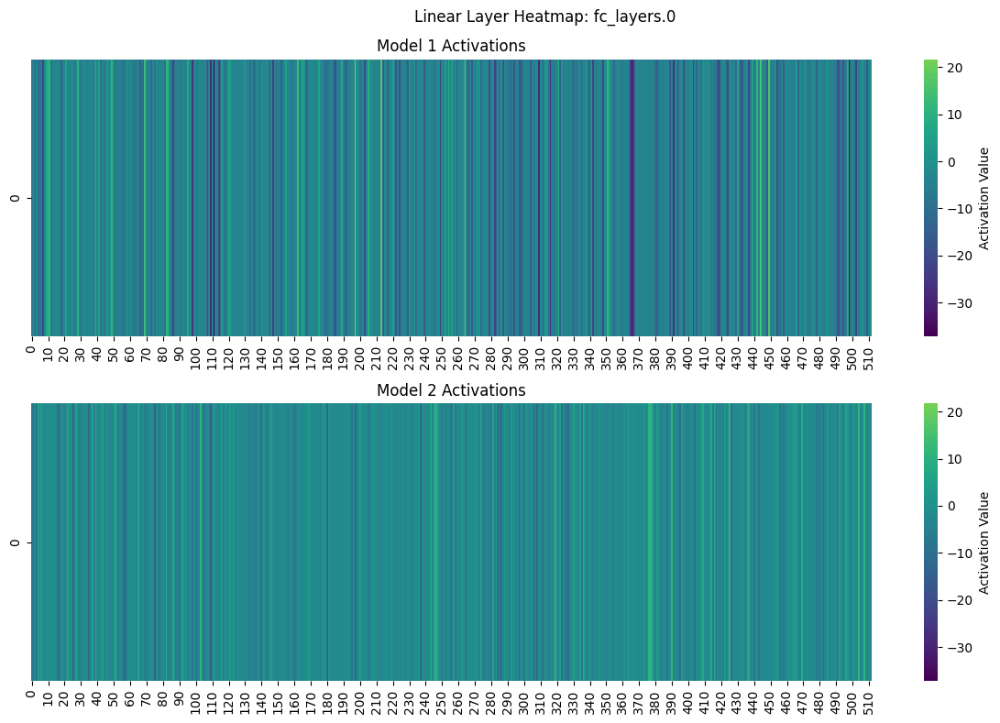

Visualizing Layer: fc_layers.3


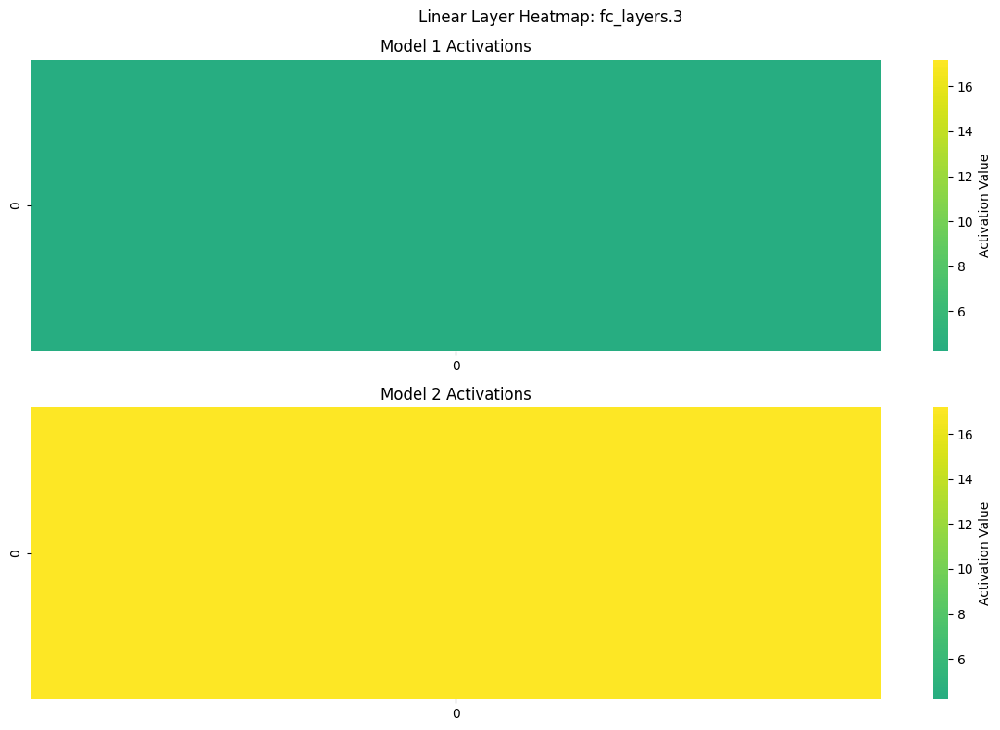

In [19]:
comparator.visualize_feature_maps_h('heatmap')

Registered hook for model1: conv_layers.0
Registered hook for model1: conv_layers.3
Registered hook for model1: conv_layers.6
Registered hook for model1: conv_layers.9
Registered hook for model1: fc_layers.0
Registered hook for model1: fc_layers.3
Registered hook for model2: conv_layers.0
Registered hook for model2: conv_layers.3
Registered hook for model2: conv_layers.6
Registered hook for model2: conv_layers.9
Registered hook for model2: fc_layers.0
Registered hook for model2: fc_layers.3
Visualizing Layer: conv_layers.0


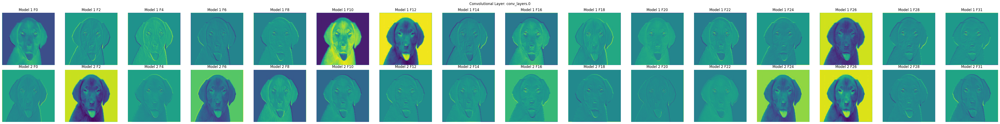

Visualizing Layer: conv_layers.3


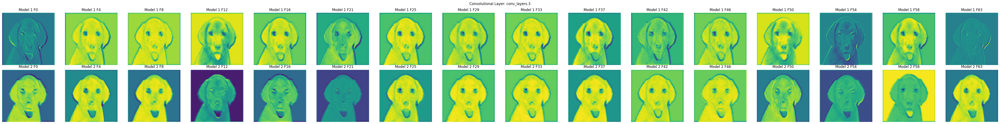

Visualizing Layer: conv_layers.6


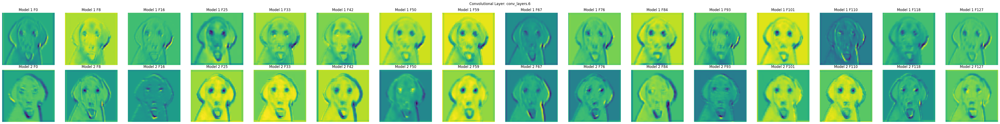

Visualizing Layer: conv_layers.9


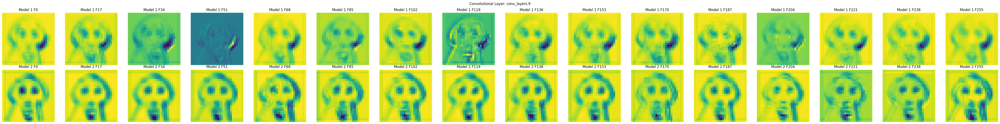

Visualizing Layer: fc_layers.0

Statistics for fc_layers.0:
Model 1:
  Mean: -5.246
  Std:  7.132
  Min:  -37.140
  Max:  21.688

Model 2:
  Mean: -1.949
  Std:  4.081
  Min:  -15.180
  Max:  11.753


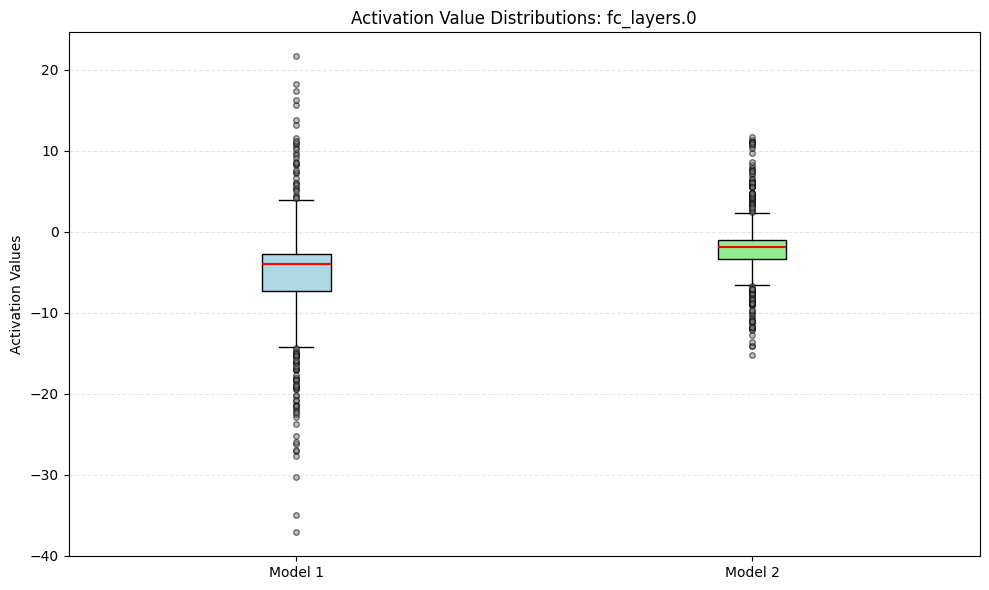

Visualizing Layer: fc_layers.3

Statistics for fc_layers.3:
Model 1:
  Mean: 4.223
  Std:  0.000
  Min:  4.223
  Max:  4.223

Model 2:
  Mean: 17.186
  Std:  0.000
  Min:  17.186
  Max:  17.186


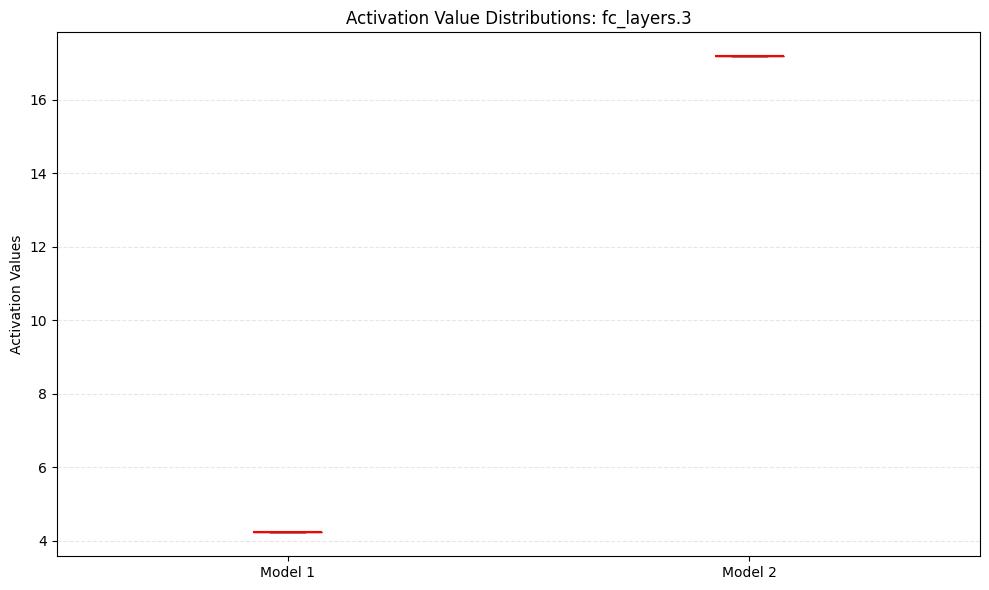

In [20]:
comparator = ModelComparison(model_1, model_2)
comparator.give_input(img.unsqueeze(0))
comparator.visualize_feature_maps_h('boxplot')